# Paper trading
I am trying to get more familiar with papertrading and api keys

https://app.alpaca.markets/dashboard/overview

In [6]:
from dotenv import load_dotenv
import os
from alpaca.trading.client import TradingClient

# This will load the .env file in the same folder as the notebook
load_dotenv(dotenv_path="./.env")

API_KEY = os.getenv("API_KEY")
SECRET_KEY = os.getenv("SECRET_KEY")

client = TradingClient(API_KEY, SECRET_KEY, paper=True)
#print("API_KEY:", API_KEY)
#print("SECRET_KEY:", SECRET_KEY)


ValueError: You must supply a method of authentication

In [2]:
from alpaca.data.historical import StockHistoricalDataClient
from alpaca.data.requests import StockTradesRequest
from alpaca.data.timeframe import TimeFrame
from datetime import datetime
import os


In [7]:
from dotenv import load_dotenv
import os
from alpaca.trading.client import TradingClient
from tabulate import tabulate

# Load API keys
load_dotenv(dotenv_path="./.env")
API_KEY = os.getenv("API_KEY")
SECRET_KEY = os.getenv("SECRET_KEY")

# Initialize the Alpaca TradingClient
client = TradingClient(API_KEY, SECRET_KEY, paper=True)

# Define the function
def list_all_orders(client):
    """
    Fetch and display all submitted orders in a tabular format.
    """
    GREEN = "\033[92m"
    RED = "\033[91m"
    YELLOW = "\033[93m"
    RESET = "\033[0m"

    def color_side(side):
        return f"{GREEN}BUY{RESET}" if side == "buy" else f"{RED}SELL{RESET}"

    def color_status(status):
        status = status.lower()
        if status in {"filled", "accepted"}:
            return f"{GREEN}{status.upper()}{RESET}"
        elif status in {"pending", "new"}:
            return f"{YELLOW}{status.upper()}{RESET}"
        else:
            return f"{RED}{status.upper()}{RESET}"

    orders = client.get_orders()

    if not orders:
        print(f"{RED}No orders found.{RESET}")
        return

    table_data = []
    for order in orders:
        table_data.append([
            order.symbol,
            color_side(order.side.value),
            order.qty,
            color_status(order.status.value)
        ])

    print(tabulate(table_data, headers=["Symbol", "Side", "Qty", "Status"], tablefmt="fancy_grid"))

# Call the function
list_all_orders(client)

ValueError: You must supply a method of authentication

#### Historical data request

In [4]:
from tabulate import tabulate

def list_all_orders(client):
    """
    Fetch and display all submitted orders in a tabular format.
    
    Args:
        client: An instance of the Alpaca TradingClient.
    """
    # Colors for order sides and status
    GREEN = "\033[92m"
    RED = "\033[91m"
    YELLOW = "\033[93m"
    RESET = "\033[0m"

    def color_side(side):
        return f"{GREEN}BUY{RESET}" if side == "buy" else f"{RED}SELL{RESET}"

    def color_status(status):
        status = status.lower()
        if status in {"filled", "accepted"}:
            return f"{GREEN}{status.upper()}{RESET}"
        elif status in {"pending", "new"}:
            return f"{YELLOW}{status.upper()}{RESET}"
        else:
            return f"{RED}{status.upper()}{RESET}"

    orders = client.get_orders()

    if not orders:
        print(f"{RED}No orders found.{RESET}")
        return

    table_data = []
    for order in orders:
        table_data.append([
            order.symbol,
            color_side(order.side.value),
            order.qty,
            color_status(order.status.value)
        ])

    print(tabulate(table_data, headers=["Symbol", "Side", "Qty", "Status"], tablefmt="fancy_grid"))

In [5]:
list_all_orders(client)

NameError: name 'client' is not defined

In [18]:
from datetime import datetime
from tabulate import tabulate
from alpaca.data.historical import StockHistoricalDataClient
from alpaca.data.requests import StockTradesRequest
from alpaca.data.timeframe import TimeFrame

# ANSI color codes
GREEN = "\033[92m"
RED = "\033[91m"
RESET = "\033[0m"

# Initialize the Alpaca data client
data_client = StockHistoricalDataClient(API_KEY, SECRET_KEY)

# Define request parameters
request_params = StockTradesRequest(
    symbol_or_symbols=["AAPL"],
    start=datetime(2024, 1, 30, 14, 30),
    end=datetime(2024, 1, 30, 15, 0),
    timeframe=TimeFrame.Minute
)

# Fetch trades
trade_response = data_client.get_stock_trades(request_params)

# Get the trades for AAPL
trades = trade_response["AAPL"]

if not trades:
    print("No trades found in the given time range.")
else:
    first_price = trades[0].price  # reference for color comparison

    # Build table rows with colored prices
    table_data = []
    for trade in trades:
        price_str = (
            f"{GREEN}{trade.price}{RESET}" if trade.price > first_price
            else f"{RED}{trade.price}{RESET}" if trade.price < first_price
            else f"{trade.price}"
        )
        table_data.append([
            trade.timestamp,
            trade.symbol,
            price_str,
            trade.size,
            trade.exchange,
            ", ".join(trade.conditions)
        ])

    # Define headers
    headers = ["Timestamp", "Symbol", "Price", "Size", "Exchange", "Conditions"]

    # Pretty print as a fancy grid
    print(tabulate(table_data, headers=headers, tablefmt="fancy_grid"))


╒══════════════════════════════════╤══════════╤═════════╤════════╤════════════╤══════════════╕
│ Timestamp                        │ Symbol   │   Price │   Size │ Exchange   │ Conditions   │
╞══════════════════════════════════╪══════════╪═════════╪════════╪════════════╪══════════════╡
│ 2024-01-30 14:30:00.001598+00:00 │ AAPL     │ 190.95  │     58 │ Q          │ @, F, T, I   │
├──────────────────────────────────┼──────────┼─────────┼────────┼────────────┼──────────────┤
│ 2024-01-30 14:30:00.002303+00:00 │ AAPL     │ 190.95  │     15 │ Q          │ @, F, T, I   │
├──────────────────────────────────┼──────────┼─────────┼────────┼────────────┼──────────────┤
│ 2024-01-30 14:30:00.002735+00:00 │ AAPL     │ 190.95  │      5 │ Q          │ @, F, T, I   │
├──────────────────────────────────┼──────────┼─────────┼────────┼────────────┼──────────────┤
│ 2024-01-30 14:30:00.003368+00:00 │ AAPL     │ 190.95  │     33 │ Q          │ @, F, T, I   │
├──────────────────────────────────┼──────────┼───

#### Market and Limit orders

In [19]:
from datetime import datetime
from tabulate import tabulate
from alpaca.trading.client import TradingClient
from alpaca.trading.requests import MarketOrderRequest, LimitOrderRequest, GetOrdersRequest
from alpaca.trading.enums import OrderSide, TimeInForce, OrderType, QueryOrderStatus
from alpaca.common.exceptions import APIError

# ANSI colors
GREEN = "\033[92m"
RED = "\033[91m"
RESET = "\033[0m"

client = TradingClient(API_KEY, SECRET_KEY, paper=True)

def format_order(order):
    """Format Alpaca order object into a displayable row."""
    return [
        order.id,
        order.symbol,
        order.qty,
        order.side.value.upper(),
        order.type.value.upper(),
        order.status.value.upper(),
        order.limit_price if order.limit_price else "-",
        order.filled_qty,
        order.filled_avg_price if order.filled_avg_price else "-",
        order.submitted_at
    ]

# === Market Order Example ===
market_order = MarketOrderRequest(
    symbol="AAPL",
    qty=1,
    side=OrderSide.BUY,
    time_in_force=TimeInForce.DAY
)

try:
    market_result = client.submit_order(market_order)
    print(f"{GREEN}Market Order Placed Successfully{RESET}")
    print(tabulate(
        [format_order(market_result)],
        headers=["ID", "Symbol", "Qty", "Side", "Type", "Status", "Limit Price", "Filled Qty", "Avg Price", "Submitted At"],
        tablefmt="fancy_grid"
    ))
except APIError as e:
    print(f"{RED}Market order failed:{RESET} {e}")

# === Limit Order Example with wash trade prevention ===
limit_order = LimitOrderRequest(
    symbol="AAPL",
    qty=1,
    side=OrderSide.SELL,
    limit_price=200.00,
    time_in_force=TimeInForce.DAY
)

# Fetch open orders for this symbol
order_filter = GetOrdersRequest(status=QueryOrderStatus.OPEN, symbols=[limit_order.symbol])
open_orders = client.get_orders(filter=order_filter)

opposite_side = OrderSide.SELL if limit_order.side == OrderSide.BUY else OrderSide.BUY
conflicting = [
    o for o in open_orders
    if o.side == opposite_side and o.type in {OrderType.MARKET, OrderType.STOP, OrderType.STOP_LIMIT}
]

if conflicting:
    print(f"{RED}Potential wash trade detected!{RESET}")
    print("Conflicting Order IDs:")
    print(tabulate([[o.id] for o in conflicting], headers=["Order ID"], tablefmt="fancy_grid"))
else:
    try:
        limit_result = client.submit_order(limit_order)
        print(f"{GREEN}Limit Order Placed Successfully{RESET}")
        print(tabulate(
            [format_order(limit_result)],
            headers=["ID", "Symbol", "Qty", "Side", "Type", "Status", "Limit Price", "Filled Qty", "Avg Price", "Submitted At"],
            tablefmt="fancy_grid"
        ))
    except APIError as e:
        print(f"{RED}Limit order failed:{RESET} {e}")


Market Order Placed Successfully
╒══════════════════════════════════════╤══════════╤═══════╤════════╤════════╤══════════╤═══════════════╤══════════════╤═════════════╤══════════════════════════════════╕
│ ID                                   │ Symbol   │   Qty │ Side   │ Type   │ Status   │ Limit Price   │   Filled Qty │ Avg Price   │ Submitted At                     │
╞══════════════════════════════════════╪══════════╪═══════╪════════╪════════╪══════════╪═══════════════╪══════════════╪═════════════╪══════════════════════════════════╡
│ 181b868b-51e7-4727-9a58-73ad962740bd │ AAPL     │     1 │ BUY    │ MARKET │ ACCEPTED │ -             │            0 │ -           │ 2025-08-10 01:35:50.611128+00:00 │
╘══════════════════════════════════════╧══════════╧═══════╧════════╧════════╧══════════╧═══════════════╧══════════════╧═════════════╧══════════════════════════════════╛
Potential wash trade detected!
Conflicting Order IDs:
╒══════════════════════════════════════╕
│ Order ID                 

#### canceling an order

In [5]:
# Cancel all open orders (alpaca-py)
from alpaca.trading.requests import GetOrdersRequest
from alpaca.trading.enums import QueryOrderStatus
from alpaca.common.exceptions import APIError

open_filter = GetOrdersRequest(status=QueryOrderStatus.OPEN)
open_orders = client.get_orders(filter=open_filter)

for order in open_orders:
    print(f"Cancelling order {order.id} for {order.symbol}")
    try:
        client.cancel_order_by_id(order.id)
    except APIError as e:
        print(f"Cancel failed for {order.id}: {e}")

Cancelling order 7fed44a0-927b-422e-906b-b3688f1207f8 for AAPL
Cancelling order b4c537d7-8db4-4d8b-bb00-152d1e596078 for MSFT
Cancelling order ffa20113-1100-41f2-8381-d893cb3bab82 for AAPL
Cancelling order d6b53c5f-e891-4aed-b23e-1d056dadb474 for AAPL


#### Get Positions

In [27]:
from tabulate import tabulate

# ANSI colors
GREEN = "\033[92m"
RED = "\033[91m"
RESET = "\033[0m"

positions = client.get_all_positions()

if not positions:
    print(f"{RED}No current positions.{RESET}")
else:
    table_data = []
    for pos in positions:
        # Color quantity green if long, red if short
        qty_color = GREEN if float(pos.qty) > 0 else RED
        table_data.append([
            pos.symbol,
            f"{qty_color}{pos.qty}{RESET}",
            f"${pos.avg_entry_price}"
        ])

    print("📊 Current Positions:")
    print(tabulate(
        table_data,
        headers=["Symbol", "Quantity", "Avg Entry Price"],
        tablefmt="fancy_grid"
    ))


📊 Current Positions:
╒══════════╤════════════╤═══════════════════╕
│ Symbol   │   Quantity │ Avg Entry Price   │
╞══════════╪════════════╪═══════════════════╡
│ AAPL     │          2 │ $214.31           │
╘══════════╧════════════╧═══════════════════╛


#### Stock Data Stream (async trade handler)

In [7]:
# Stock Data Stream (safe for notebooks: run in a background thread)
import threading
from alpaca.data.live import StockDataStream

stream = StockDataStream(API_KEY, SECRET_KEY)

async def handle_trade(data):
    print(f"Trade update: {data}")

# Subscribe to AAPL trades
stream.subscribe_trades(handle_trade, "AAPL")

# Start the stream in a background thread to avoid asyncio.run() conflicts
stream_thread = threading.Thread(target=stream.run, daemon=True)
stream_thread.start()
print("Streaming started. To stop later, call: stream.stop()")

Streaming started. To stop later, call: stream.stop()


data websocket error, restarting connection: no close frame received or sent
data websocket error, restarting connection: no close frame received or sent
error during websocket communication: [Errno 11001] getaddrinfo failed
Traceback (most recent call last):
  File "c:\Users\Windows User\AppData\Local\Programs\Python\Python313\Lib\site-packages\alpaca\data\live\websocket.py", line 343, in _run_forever
    await self._start_ws()
  File "c:\Users\Windows User\AppData\Local\Programs\Python\Python313\Lib\site-packages\alpaca\data\live\websocket.py", line 134, in _start_ws
    await self._connect()
  File "c:\Users\Windows User\AppData\Local\Programs\Python\Python313\Lib\site-packages\alpaca\data\live\websocket.py", line 98, in _connect
    self._ws = await websockets_legacy.connect(
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
    ...<3 lines>...
    )
    ^
  File "c:\Users\Windows User\AppData\Local\Programs\Python\Python313\Lib\site-packages\websockets\legacy\client.py", line 654, i

#### Connecting functions for automated trading

In [8]:
# ...existing code...
%pip install -U yfinance "websockets<14"
# ...existing code...

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [9]:
# ...existing code...
import sys
from pathlib import Path

project_root = Path(r"c:\Users\Windows User\My_folder\Finance_project")
sys.path.append(str(project_root))

from trading_functions import unified_bayesian_gp_forecast

print("✅ Successfully imported unified_bayesian_gp_forecast")
# ...existing code...

✅ Successfully imported unified_bayesian_gp_forecast


[*********************100%***********************]  1 of 1 completed



🔵 Running Bayesian Linear Regression for AAPL...
🟠 Running Gaussian Process for AAPL...


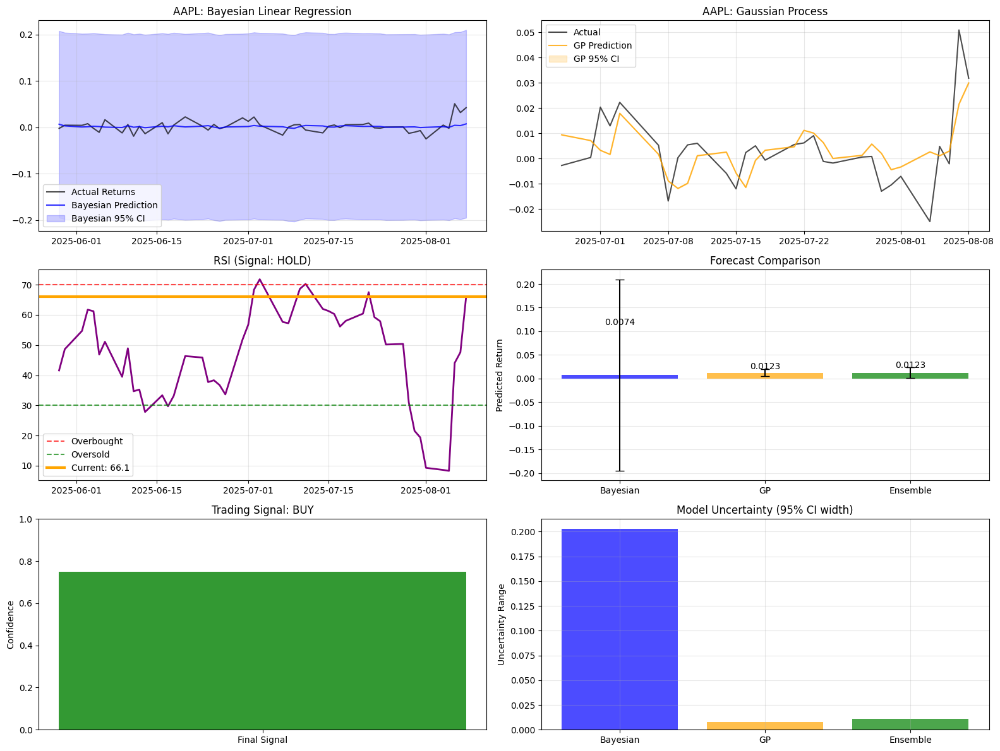


📊 AAPL - Unified Forecast Summary (2025-08-08)
🔵 Bayesian Forecast: 0.0074 ± 0.2026
🟠 GP Forecast:       0.0123 ± 0.0077
🟢 Ensemble Forecast: 0.0123 ± 0.0111
📈 RSI Signal:        HOLD (RSI: 66.1)
🎯 Final Signal:      BUY (Confidence: 75.0%)
💰 Recommendation:    BUY
╒══════════╤══════════╤══════════════╤═════════════════╤═════════════════════╕
│ Symbol   │ Signal   │ Confidence   │ Action Taken    │ Timestamp           │
╞══════════╪══════════╪══════════════╪═════════════════╪═════════════════════╡
│ AAPL     │ BUY      │ 75.0%        │ ✅ Order Placed │ 2025-08-09 18:41:51 │
╘══════════╧══════════╧══════════════╧═════════════════╧═════════════════════╛


In [21]:
from tabulate import tabulate
from datetime import datetime
import pandas as pd

# Colors for terminal output
GREEN = "\033[92m"
RED = "\033[91m"
YELLOW = "\033[93m"
RESET = "\033[0m"

def color_signal(sig):
    if sig == "buy":
        return f"{GREEN}BUY{RESET}"
    elif sig == "sell":
        return f"{RED}SELL{RESET}"
    return f"{YELLOW}HOLD{RESET}"

symbol = "AAPL"
res = unified_bayesian_gp_forecast(symbol)

signal = None
confidence = None

# --- Forecast Parsing ---
if isinstance(res, dict):
    signal = (res.get("final_signal") or res.get("signal") or res.get("action"))
    confidence = (res.get("final_confidence") or res.get("confidence") or res.get("prob") or res.get("score"))
elif isinstance(res, pd.DataFrame):
    row = res.iloc[0]
    signal = (row.get("final_signal") or row.get("signal") or row.get("action"))
    confidence = (row.get("final_confidence") or row.get("confidence") or row.get("prob") or row.get("score"))
elif isinstance(res, (list, tuple)) and len(res) >= 2 and str(res[0]).lower() in {"buy","sell","hold"}:
    signal, confidence = res[0], res[1]

# Normalize
if isinstance(signal, str):
    signal = signal.lower()

if isinstance(confidence, str):
    txt = confidence.strip().replace("%","")
    try:
        confidence = float(txt)
    except ValueError:
        confidence = None

if isinstance(confidence, (int, float)) and confidence > 1:
    confidence = confidence / 100.0

# --- Trading Decision ---
order_result = None
if signal in {"buy","sell"} and isinstance(confidence, (int, float)) and confidence > 0.7:
    side = OrderSide.BUY if signal == "buy" else OrderSide.SELL
    order = MarketOrderRequest(symbol=symbol, qty=1, side=side, time_in_force=TimeInForce.DAY)
    order_result = client.submit_order(order)

# --- Table Output ---
table_data = [[
    symbol,
    color_signal(signal),
    f"{confidence*100:.1f}%" if confidence else "N/A",
    "✅ Order Placed" if order_result else "❌ No Trade",
    datetime.now().strftime("%Y-%m-%d %H:%M:%S")
]]

print(tabulate(
    table_data,
    headers=["Symbol", "Signal", "Confidence", "Action Taken", "Timestamp"],
    tablefmt="fancy_grid"
))

# Optional: Show debug info if no trade made
if not order_result:
    print("\nDebug → type:", type(res))
    if isinstance(res, pd.DataFrame):
        print("Columns:", list(res.columns))
        print(res.head(1))
    elif isinstance(res, dict):
        print("Keys:", list(res.keys()))


#### Risk Managment

In [22]:
from tabulate import tabulate
from datetime import datetime

# Colors for terminal output
GREEN = "\033[92m"
RED = "\033[91m"
CYAN = "\033[96m"
RESET = "\033[0m"

# --- Position Sizing Function ---
def calculate_position_size(account_cash, entry_price, stop_loss_price, risk_percent=1.0):
    """
    Calculate position size based on risk percent of account.
    """
    risk_amount = account_cash * (risk_percent / 100)
    risk_per_share = abs(entry_price - stop_loss_price)
    if risk_per_share == 0:
        return 0
    return int(risk_amount / risk_per_share)

# --- Example Usage ---
symbol = "AAPL"
account = client.get_account()
account_cash = float(account.cash)
entry_price = 200.00
stop_loss_price = 195.00
risk_percent = 1.0

shares_to_buy = calculate_position_size(account_cash, entry_price, stop_loss_price, risk_percent)

# --- Place Order ---
order_result = None
if shares_to_buy > 0:
    order = MarketOrderRequest(
        symbol=symbol,
        qty=shares_to_buy,
        side=OrderSide.BUY,
        time_in_force=TimeInForce.DAY
    )
    order_result = client.submit_order(order)

# --- Table Output ---
table_data = [[
    symbol,
    f"${account_cash:,.2f}",
    f"${entry_price:.2f}",
    f"${stop_loss_price:.2f}",
    f"{risk_percent:.1f}%",
    f"{shares_to_buy:,} shares",
    f"{GREEN}✅ Order Placed{RESET}" if order_result else f"{RED}❌ No Trade{RESET}",
    datetime.now().strftime("%Y-%m-%d %H:%M:%S")
]]

print(tabulate(
    table_data,
    headers=["Symbol", "Cash Available", "Entry Price", "Stop-Loss", "Risk %", "Position Size", "Order Status", "Timestamp"],
    tablefmt="fancy_grid"
))

# --- Optional: Debug Order Details ---
if order_result:
    print(f"\n{CYAN}Order ID:{RESET}", order_result.id)
    print(f"{CYAN}Status:{RESET}", order_result.status)


╒══════════╤══════════════════╤═══════════════╤═════════════╤══════════╤═════════════════╤═════════════════╤═════════════════════╕
│ Symbol   │ Cash Available   │ Entry Price   │ Stop-Loss   │ Risk %   │ Position Size   │ Order Status    │ Timestamp           │
╞══════════╪══════════════════╪═══════════════╪═════════════╪══════════╪═════════════════╪═════════════════╪═════════════════════╡
│ AAPL     │ $99,571.37       │ $200.00       │ $195.00     │ 1.0%     │ 199 shares      │ ✅ Order Placed │ 2025-08-09 18:43:56 │
╘══════════╧══════════════════╧═══════════════╧═════════════╧══════════╧═════════════════╧═════════════════╧═════════════════════╛

Order ID: c7798931-57cc-46cf-9456-c026d35b4dee
Status: OrderStatus.ACCEPTED


### Checking account status

In [23]:
account = client.get_account()

print(f"Account Status: {account.status.value}")  # Print status as a string, e.g., "ACTIVE"
print(f"Available Cash: ${float(account.cash):,.2f}")
print(f"Portfolio Value: ${float(account.portfolio_value):,.2f}")
print(f"Buying Power: ${float(account.buying_power):,.2f}")

Account Status: ACTIVE
Available Cash: $99,571.37
Portfolio Value: $100,030.07
Buying Power: $106,860.59


### Viewing current positions

In [25]:
from tabulate import tabulate

# ANSI color codes
GREEN = "\033[92m"
RED = "\033[91m"
RESET = "\033[0m"

positions = client.get_all_positions()

if not positions:
    print(f"{RED}No current positions.{RESET}")
else:
    table_data = []
    for pos in positions:
        qty_color = GREEN if float(pos.qty) > 0 else RED  # green if long, red if short
        table_data.append([
            pos.symbol,
            f"{qty_color}{pos.qty}{RESET}",
            f"${float(pos.avg_entry_price):.2f}"
        ])

    print("📊 Current Positions:")
    print(tabulate(
        table_data,
        headers=["Symbol", "Quantity", "Avg Entry Price"],
        tablefmt="fancy_grid"
    ))


📊 Current Positions:
╒══════════╤════════════╤═══════════════════╕
│ Symbol   │   Quantity │ Avg Entry Price   │
╞══════════╪════════════╪═══════════════════╡
│ AAPL     │          2 │ $214.31           │
╘══════════╧════════════╧═══════════════════╛


### Listing all submitted Orders

In [26]:
from tabulate import tabulate

# Colors for order sides and status
GREEN = "\033[92m"
RED = "\033[91m"
YELLOW = "\033[93m"
RESET = "\033[0m"

def color_side(side):
    return f"{GREEN}BUY{RESET}" if side == "buy" else f"{RED}SELL{RESET}"

def color_status(status):
    status = status.lower()
    if status in {"filled", "accepted"}:
        return f"{GREEN}{status.upper()}{RESET}"
    elif status in {"pending", "new"}:
        return f"{YELLOW}{status.upper()}{RESET}"
    else:
        return f"{RED}{status.upper()}{RESET}"

orders = client.get_orders()

table_data = []
for order in orders:
    table_data.append([
        order.symbol,
        color_side(order.side.value),
        order.qty,
        color_status(order.status.value)
    ])

print(tabulate(table_data, headers=["Symbol", "Side", "Qty", "Status"], tablefmt="fancy_grid"))


╒══════════╤════════╤═══════╤══════════╕
│ Symbol   │ Side   │   Qty │ Status   │
╞══════════╪════════╪═══════╪══════════╡
│ AAPL     │ BUY    │   199 │ ACCEPTED │
├──────────┼────────┼───────┼──────────┤
│ AAPL     │ BUY    │     1 │ ACCEPTED │
├──────────┼────────┼───────┼──────────┤
│ AAPL     │ BUY    │     1 │ ACCEPTED │
├──────────┼────────┼───────┼──────────┤
│ MSFT     │ BUY    │     1 │ ACCEPTED │
├──────────┼────────┼───────┼──────────┤
│ AAPL     │ BUY    │   199 │ ACCEPTED │
├──────────┼────────┼───────┼──────────┤
│ AAPL     │ BUY    │     1 │ ACCEPTED │
╘══════════╧════════╧═══════╧══════════╛


In [14]:
orders = client.get_orders()
for order in orders:
    print(f"{order.symbol} {order.side} {order.qty} - {order.status}")

AAPL OrderSide.BUY 199 - OrderStatus.ACCEPTED
AAPL OrderSide.BUY 1 - OrderStatus.ACCEPTED
